In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from pmdarima import auto_arima
from prophet import Prophet
from sklearn.preprocessing import MinMaxScaler
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Input, LSTM, Dense
from arch import arch_model
from sklearn.ensemble import IsolationForest
from statsmodels.tsa.seasonal import STL
import backtrader as bt
import streamlit as st
import plotly.graph_objects as go
import hvplot.pandas            # добавляет аксессор .hvplot
import holoviews as hv
hv.extension('bokeh')           # backend для вывода в ноутбуке / Streamlit
import pmdarima as pm
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller 

In [2]:
# ── 0. параметры чтения ─────────────────────────────────────────
dtype_spec = {
    'Open':   'float32',
    'High':   'float32',
    'Low':    'float32',
    'Close':  'float32',
    'Volume': 'float32'          # столбец‑6, где была смешанная типизация
}

df = pd.read_csv(
        'btcusd_1-min_data.csv',
        dtype=dtype_spec,        # явно задаём типы
        low_memory=False         # читаем одним куском ⇒ нет DtypeWarning
)

# ── 1. перевод времени ──────────────────────────────────────────
df['datetime'] = pd.to_datetime(df['Timestamp'], unit='s', utc=True)

# ── 2. убираем лишнее и делаем datetime индексом ────────────────
df.drop(columns='Timestamp', inplace=True)  # Удаляем ТОЛЬКО Timestamp
df.set_index('datetime', inplace=True)

# ── 3. проверка и промахи частоты ───────────────────────────────
df = df.asfreq('1min')           # создаёт «полный» минутный индекс
df.interpolate(method='time', inplace=True)  # заполняем возможные дыры

# ── 4. фильтрация нулевых объёмов ───────────────────────────────
df = df[df['Volume'] > 0].copy()

# ── 5. базовые признаки ─────────────────────────────────────────
df['return']      = df['Close'].pct_change()
df['log_return']  = np.log(df['Close'] / df['Close'].shift(1))
df['MA_50']       = df['Close'].rolling(50).mean()
df['MA_200']      = df['Close'].rolling(200).mean()
df['vol_1h']      = df['return'].rolling(60).std()

df.dropna(inplace=True)
print(df.head())

                           Open  High  Low  Close    Volume  return  \
datetime                                                              
2012-01-13 22:11:00+00:00   6.9   6.9  6.9    6.9  1.466276     0.0   
2012-01-13 22:12:00+00:00   6.9   6.9  6.9    6.9  1.466276     0.0   
2012-01-13 22:13:00+00:00   6.9   6.9  6.9    6.9  1.466276     0.0   
2012-01-13 22:15:00+00:00   6.9   6.9  6.9    6.9  1.466276     0.0   
2012-01-13 22:16:00+00:00   6.9   6.9  6.9    6.9  1.466276     0.0   

                           log_return   MA_50   MA_200    vol_1h  
datetime                                                          
2012-01-13 22:11:00+00:00         0.0  7.0646  6.59635  0.035533  
2012-01-13 22:12:00+00:00         0.0  7.0586  6.60665  0.035533  
2012-01-13 22:13:00+00:00         0.0  7.0526  6.61615  0.031996  
2012-01-13 22:15:00+00:00         0.0  7.0466  6.62565  0.031779  
2012-01-13 22:16:00+00:00         0.0  7.0406  6.63355  0.031779  


<Axes: title={'center': 'Bitcoin – Close price'}, xlabel='datetime'>

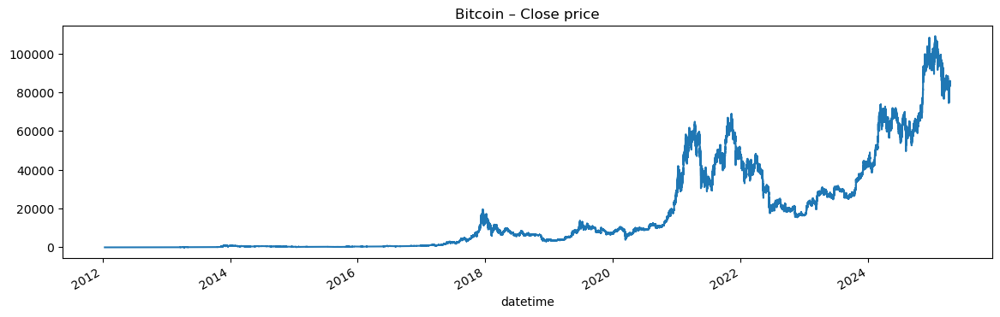

In [3]:
# ── 2.1 общая динамика цены ─────────────────────────────────────
df['Close'].plot(figsize=(14,4), title='Bitcoin – Close price')

Text(0.5, 1.0, 'Distrib. of 1‑min returns')

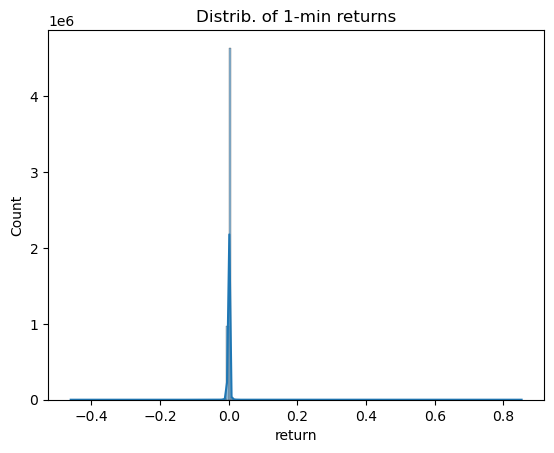

In [4]:
# ── 2.2 распределение минутных доходностей ──────────────────────
sns.histplot(df['return'], bins=200, kde=True)
plt.title('Distrib. of 1‑min returns')

<Axes: >

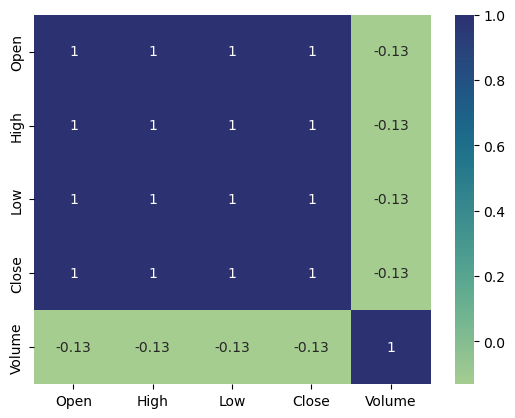

In [5]:
# ── 2.3 тепловая карта корреляций ───────────────────────────────
sns.heatmap(df[['Open','High','Low','Close','Volume']].corr(),
            annot=True, cmap='crest')

In [6]:
plot_df = df['Close'].iloc[::30]                # каждые 30 минут
fig = px.line(plot_df, title='BTC price (30‑min)', render_mode='webgl')
fig.show()

In [7]:
# 1) 15‑мин ряд
ser = (
    df['Close']
      .resample('15min').last()        # регулярный 15‑мин ряд
      .dropna()
      .astype('float32')
)

# сделать PeriodIndex, что нравится statsmodels
ser.index = ser.index.to_period('15min')

# 2) 90‑дней окно
train = ser[-90*24*4:]                     # 90×24×4 = 8 640 точек
test  = ser[-2*24*4:]                      # 2‑сутки вперёд

# 3) авто‑ARIMA
model = pm.auto_arima(
    train,
    d=None,              # пускай подберёт d via KPSS/ADF
    max_p=3, max_q=3,
    seasonal=False,
    information_criterion='aic',
    stepwise=True,
    trace=True,
    error_action='ignore',
    suppress_warnings=True,
    n_jobs=1             # многопроцессность ≈ удвоит RAM, поэтому off
)

# прогноз → упакуем его обратно в Series с тем же индексом, что и test
pred = pd.Series(
    model.predict(n_periods=len(test)),
    index=test.index
)

C:\Users\WINDOWS 10\AppData\Local\Temp\ipykernel_6020\497240745.py:10: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.



Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=122130.211, Time=4.49 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=122156.218, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=122152.265, Time=0.38 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=122151.961, Time=0.42 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=122154.420, Time=0.09 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=122147.869, Time=1.60 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=122147.288, Time=1.92 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=122150.612, Time=2.22 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=122124.487, Time=6.50 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=122148.759, Time=2.97 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=122126.520, Time=10.38 sec
 ARIMA(2,1,3)(0,0,0)[0]             : AIC=122122.595, Time=3.03 sec
 ARIMA(1,1,3)(0,0,0)[0]             : AIC=122150.761, Time=0.50 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=122128.271, Time=2.23 sec
 ARI

14:29:56 - cmdstanpy - INFO - Chain [1] start processing
14:30:08 - cmdstanpy - INFO - Chain [1] done processing


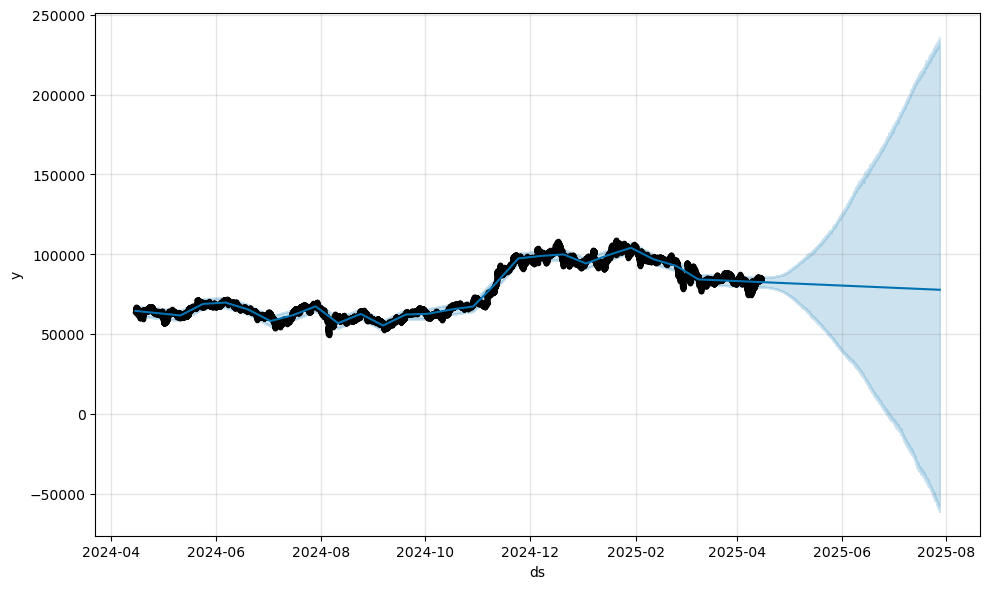

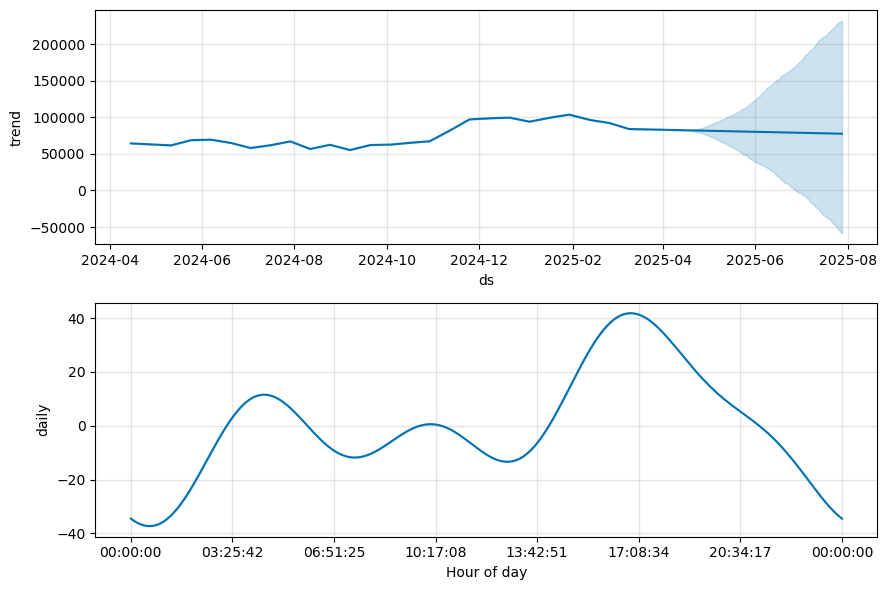

In [8]:
# 1) 15‑минутный ряд и последние 12 месяцев
ser15 = df['Close'].resample('15min').last()
ser12m = ser15.loc[ser15.index.max() - pd.Timedelta(days=365):]

df_prop = ser12m.reset_index().rename(columns={'datetime':'ds', 'Close':'y'})
df_prop['ds'] = df_prop['ds'].dt.tz_localize(None)

# 2) модель (только daily seasonality, всё остальное off)
model = Prophet(
    daily_seasonality=True,
    weekly_seasonality=False,
    yearly_seasonality=False,
    changepoint_range=0.9,
    stan_backend='CMDSTANPY'
)

model.fit(df_prop)                          # ← без kwargs

# 3) прогноз вперёд на 10 000 минут (≈ 1 w 6 h)
future   = model.make_future_dataframe(periods=10_000, freq='15min')
forecast = model.predict(future)

fig1 = model.plot(forecast)             # цена + прогноз
fig2 = model.plot_components(forecast)  # тренд и сезонность

In [9]:
# ───────────────────────────────────────────────────────────────
# 1.  Подготовка данных
# ───────────────────────────────────────────────────────────────
# 15‑мин ресемплинг, чтобы ускорить обучение
series = df['Close'].resample('15min').last().dropna().astype('float32')

# train‑test split  (последние 2 недели — тест)
train_size = -24*4*14
train, test = series[:train_size], series[train_size:]

# масштабируем на основе train 
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_train = scaler.fit_transform(train.values.reshape(-1, 1))
scaled_full  = scaler.transform(series.values.reshape(-1, 1))

# ───────────────────────────────────────────────────────────────
# 2.  Генерация окон для LSTM
# ───────────────────────────────────────────────────────────────
win = 60                 # 15 мин × 60 = 15 часов “контекста”
X, y = [], []
for i in range(win, len(scaled_full)):
    X.append(scaled_full[i - win:i, 0])
    y.append(scaled_full[i, 0])

X = np.array(X)                       # (samples, timesteps)
y = np.array(y)
X = X[..., np.newaxis]                # → (samples, timesteps, features=1)

# ───────────────────────────────────────────────────────────────
# 3.  Модель без предупреждений Keras
# ───────────────────────────────────────────────────────────────
model = keras.Sequential([
    Input(shape=(win, 1)),
    LSTM(64, return_sequences=True),
    LSTM(32),
    Dense(1)
])
model.compile(optimizer='adam', loss='mse')

# ───────────────────────────────────────────────────────────────
# 4.  Обучение
# ───────────────────────────────────────────────────────────────
# 1‑2 эпохи на полном наборе дадут базовый результат;
model.fit(X, y, epochs=5, batch_size=256, verbose=2)

# ───────────────────────────────────────────────────────────────
# 5.  Прогноз (на пример последних 200 точек)
# ───────────────────────────────────────────────────────────────
last_win  = scaled_full[-win:]                      # (60,1)
last_win  = last_win[np.newaxis, ...]               # (1,60,1)
pred_norm = model.predict(last_win)
pred_real = scaler.inverse_transform(pred_norm)     # вернуть в цены

print("Следующая 15‑мин цена ≈", pred_real.ravel()[0])

Epoch 1/5
1716/1716 - 92s - 54ms/step - loss: 1.6222e-04
Epoch 2/5
1716/1716 - 89s - 52ms/step - loss: 5.6487e-06
Epoch 3/5
1716/1716 - 90s - 52ms/step - loss: 5.8800e-06
Epoch 4/5
1716/1716 - 143s - 83ms/step - loss: 5.1230e-06
Epoch 5/5
1716/1716 - 90s - 53ms/step - loss: 4.3578e-06
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
Следующая 15‑мин цена ≈ 84771.49


In [10]:
# 1) масштаб: доходности ×1000
rets = df['Close'].pct_change().dropna() * 1000

# 2) модель GARCH(1,1)
garch = arch_model(rets, vol='GARCH', p=1, q=1, rescale=False)

# 3) фит: LBFGS (по умолчанию) + больше итераций
res = garch.fit(
        disp='off',              # не выводить шаги
        update_freq=0,           # 0 — полностью тихий режим
        options={'maxiter': 1500, 'ftol': 1e-8}  # настройки SciPy
)

print(res.summary())

                     Constant Mean - GARCH Model Results                      
Dep. Variable:                  Close   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:           -8.41567e+06
Distribution:                  Normal   AIC:                       1.68314e+07
Method:            Maximum Likelihood   BIC:                       1.68314e+07
                                        No. Observations:              5678646
Date:                Thu, May 08 2025   Df Residuals:                  5678645
Time:                        14:39:02   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
mu         1.7969e-03  3.610e-04      4.978  6.441e-07 [1.

In [13]:
log_ret = np.log(
    df['Close'].resample('15min').last()
).diff().dropna()

end   = log_ret.index.max()                   # последняя метка
start = end - pd.Timedelta(days=365)          # 365 дней назад
sub   = log_ret.loc[start:end]                # срез без .last()

# 2) ADF с фиксированным maxlag
result = adfuller(sub, maxlag=20, autolag=None)
print(f"ADF statistic = {result[0]:.3f},  p‑value = {result[1]:.4f}")

ADF statistic = -41.088,  p‑value = 0.0000


In [14]:
iso = IsolationForest(contamination=0.002, random_state=42)
df['anomaly'] = iso.fit_predict(df[['log_return','Volume']])
# ‑1 = аномалия

In [15]:
z = (df['log_return'] - df['log_return'].mean())/df['log_return'].std()
df['anomaly_z'] = (np.abs(z) > 5)  # ‑> True/False

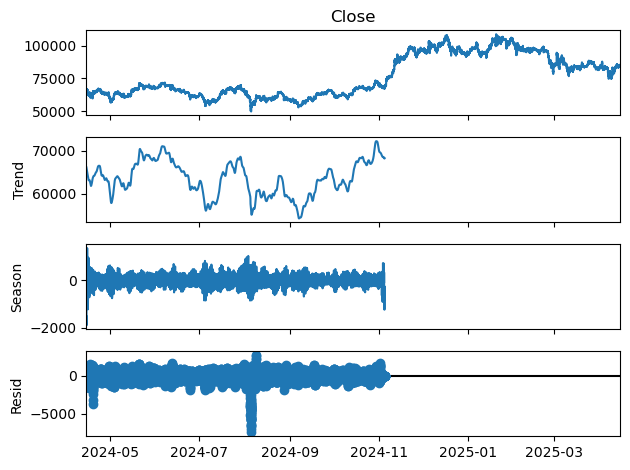

In [16]:
close_15 = (
    df['Close']
      .resample('15min')
      .last()
      .dropna()
      .asfreq('15min')      # ← фиксируем частоту в индексе
)

end   = close_15.index.max()
start = end - pd.Timedelta(days=365)
sub   = close_15.loc[start:end]

stl = STL(sub, period=96, robust=True)  # robust сглаживание + меньше точек
res = stl.fit()
res.plot();               # строится < 3 cек

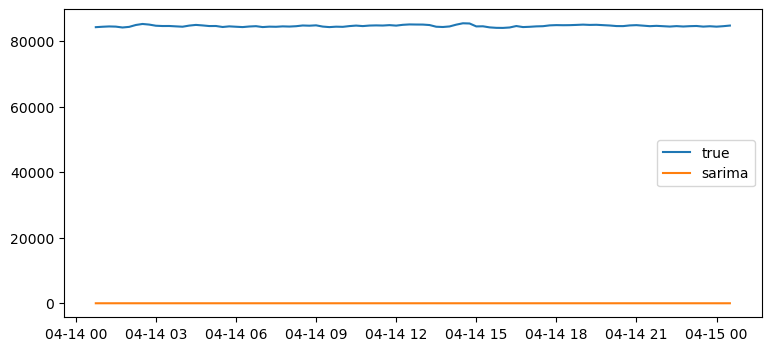

In [24]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX

# 1) 15‑минутный ряд, 120 дней истории  ─────────────────────────
close15 = (
    df['Close']
      .resample('15min').last()
      .dropna()
      .asfreq('15min')                      # фиксируем freq → нет ValueWarning
)

end   = close15.index.max()
start = end - pd.Timedelta(days=120)
sub   = close15.loc[start:end]             # вместо .last('120D')

train, test = sub[:-96], sub[-96:]         # сутки = 96×15 мин

# 2) строим модель (15‑минут, суточная сезонность = 96) ──────────
mod = SARIMAX(
    train,
    order=(1,1,1),
    seasonal_order=(1,0,1,96),
    simple_differencing=True               # экономит RAM + быстрее
)

# 3) fit: low_memory сохраняет ТОЛЬКО текущие ковариации ─────────
fit_res = mod.fit(disp=False, low_memory=True, maxiter=200)

# 4) прогноз                                                      
pred = fit_res.get_forecast(steps=len(test)).predicted_mean

plt.figure(figsize=(9,4))
plt.plot(test.index, test, label='true')
plt.plot(test.index, pred, label='sarima')
plt.legend(); plt.show()